In [1]:
import torch

from bikebench.design_evaluation.design_evaluation import *
from bikebench.data_loading import data_loading
# from bikebench.design_evaluation.scoring import *
# from bikebench.design_evaluation.score_report import *

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

/home/mileva/mambaforge/envs/bike-bench-cuda/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In this notebook, we visualize the geometric constraints to check that they are all roughly functional. 

In [2]:
data = data_loading.load_bike_bench_train()
data_tens = torch.tensor(data.values, dtype=torch.float32, device=device)


evaluator, requirement_names, is_objective, is_constraint = construct_tensor_evaluator([ValidationEvaluator(device=device)], data.columns)
eval_scores = evaluator(data_tens, None)


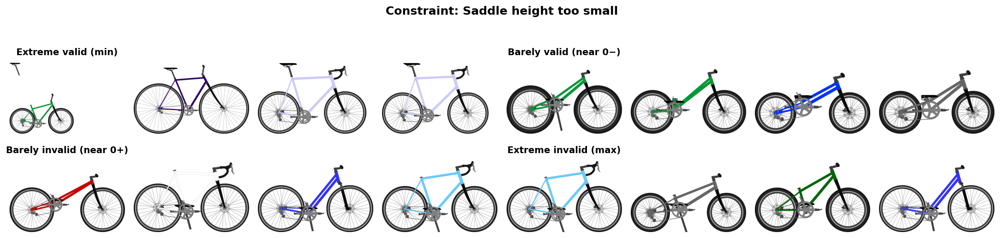

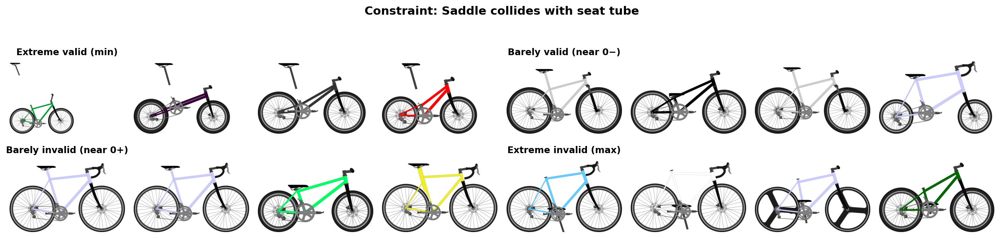

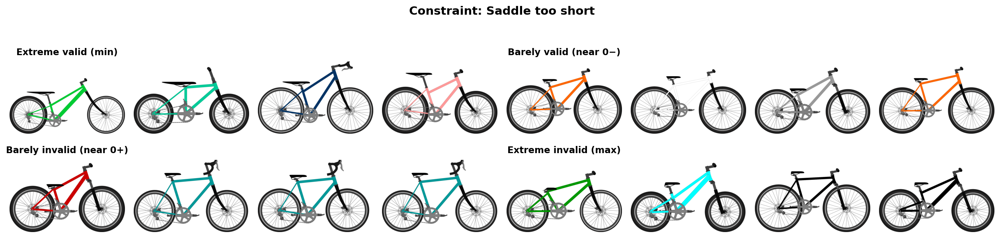

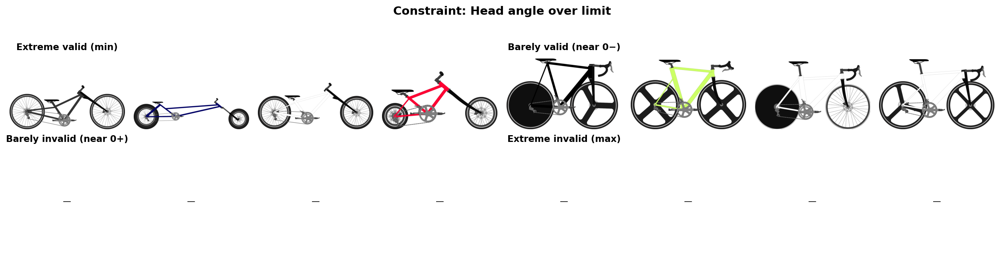

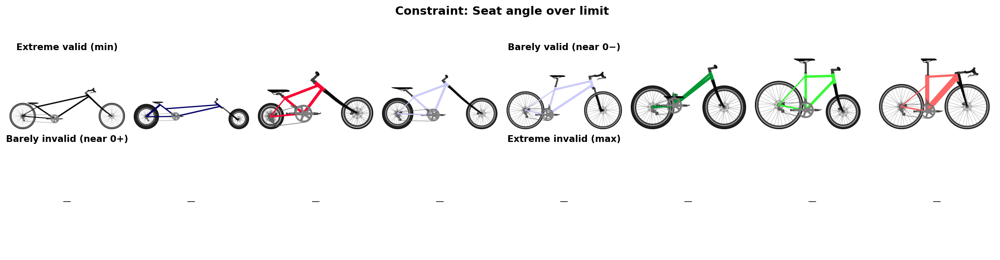

...

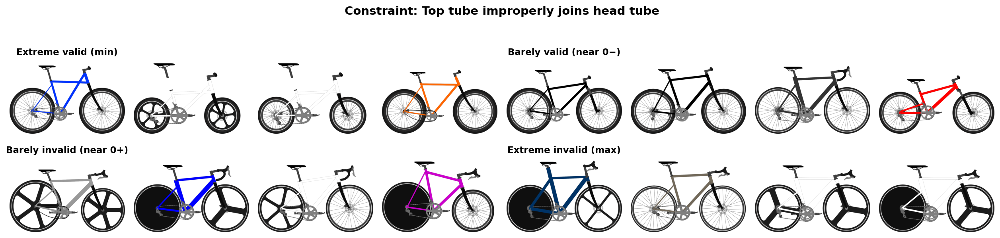

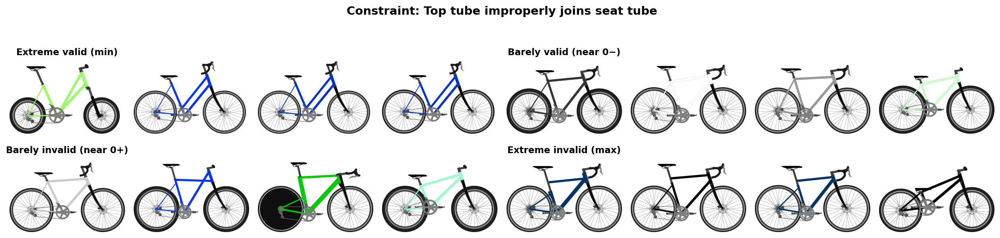

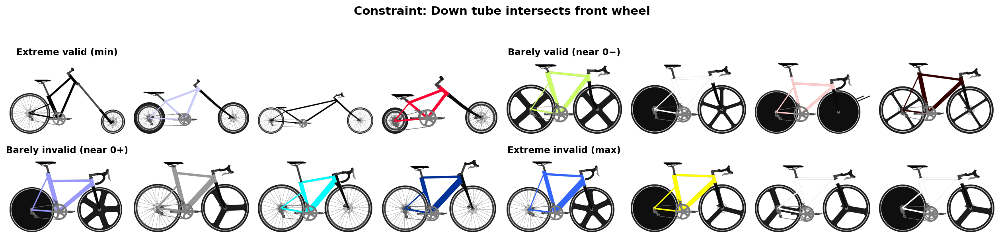

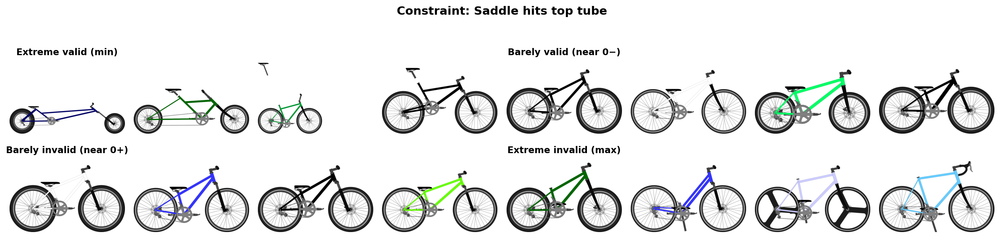

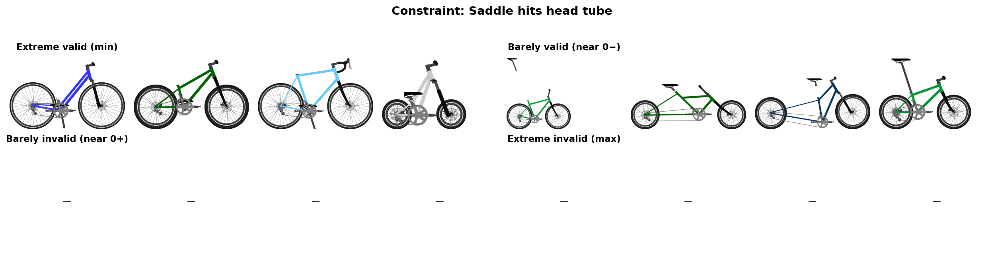

In [3]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from PIL import Image
# ---- layout ----
ROWS, COLS = 2, 8
K = 4  # images per group

# tensors -> numpy
scores_np = eval_scores.detach().cpu().numpy()        # [N, C]
req_types_np = np.array(is_objective)
constraint_idx_list = np.where(req_types_np == 0)[0]  # 0 = constraints

# map DataFrame index -> image id (handles '(123)' or '123')
def _to_img_id(x):
    s = str(x).strip()
    if s.startswith("(") and s.endswith(")"):
        s = s[1:-1]
    return int(s)

ROW_IDS = np.array([_to_img_id(x) for x in data.index.values])

def _load_img(image_id: int):
    path = data_loading.load_png(int(image_id))  # relies on local/extracted data
    return Image.open(path).convert("RGB")

def _select_groups(col_scores: np.ndarray):
    """Return 4 arrays of row positions: extreme valid, barely valid, barely invalid, extreme invalid."""
    valid_pos   = np.where(col_scores <= 0.0)[0]
    invalid_pos = np.where(col_scores >  0.0)[0]

    # extreme valid: most negative
    ev = valid_pos[np.argsort(col_scores[valid_pos])[:K]]

    # barely valid: closest to 0 from below (largest values among valid)
    bv = valid_pos[np.argsort(-col_scores[valid_pos])[:K]]

    # barely invalid: closest to 0 from above (smallest positive)
    bi = invalid_pos[np.argsort(col_scores[invalid_pos])[:K]]

    # extreme invalid: most positive
    ei = invalid_pos[np.argsort(-col_scores[invalid_pos])[:K]]

    return ev, bv, bi, ei

def _draw_row_block(ax_grid, row: int, col_start: int, ids, title: str):
    """Draw up to 4 images in a single row starting at col_start."""
    ax_grid[row, col_start].set_title(title, fontsize=11, weight="bold", pad=8)
    ids = list(ids)[:K]
    # pad so we always fill 4 slots
    ids += [None] * (K - len(ids))
    for j in range(K):
        ax = ax_grid[row, col_start + j]
        ax.axis("off")
        iid = ids[j]
        if iid is None:
            ax.text(0.5, 0.5, "—", ha="center", va="center", fontsize=10)
            continue
        try:
            ax.imshow(_load_img(int(iid)))
        except Exception:
            ax.text(0.5, 0.5, f"missing: {iid}", ha="center", va="center", fontsize=9)

def plot_constraint_comparisons():
    for ci in constraint_idx_list:
        name = requirement_names[ci]
        col = scores_np[:, ci]

        ev_pos, bv_pos, bi_pos, ei_pos = _select_groups(col)

        # translate row positions -> image IDs
        ev_ids = ROW_IDS[ev_pos]
        bv_ids = ROW_IDS[bv_pos]
        bi_ids = ROW_IDS[bi_pos]
        ei_ids = ROW_IDS[ei_pos]

        fig, axes = plt.subplots(ROWS, COLS, figsize=(COLS * 2.1, ROWS * 2.2), dpi=150)
        axes = np.atleast_2d(axes)

        fig.suptitle(f"Constraint: {name}", y=0.98, fontsize=14, weight="bold")

        # top row: extreme valid | barely valid
        _draw_row_block(axes, 0, 0, ev_ids, "Extreme valid (min)")
        _draw_row_block(axes, 0, 4, bv_ids, "Barely valid (near 0−)")
        # bottom row: barely invalid | extreme invalid
        _draw_row_block(axes, 1, 0, bi_ids, "Barely invalid (near 0+)")
        _draw_row_block(axes, 1, 4, ei_ids, "Extreme invalid (max)")

        plt.tight_layout(rect=[0, 0, 1, 0.96])
        plt.show()
        plt.close(fig)

# run it
plot_constraint_comparisons()
